# CS470 Introduction to Artificial Intelligence
## KAIST Spring 2023


---
## Team S04

### Group Members
* Si Hao Lee 20236101
* Christopher Lye 20236100
* Kellie Sim 20236097
* Brandon Tan 20236078
* Chan Mun Won Lee 20236023

---
## Sterile Instrument Transporter (SIT)

### Objectives
1. To develop Computer Vision capable of accurately detecting thorough sterilization, characterized by the following functionalities:

  * the ability to detect the presence of a strip with the correct shade of dark green on the External Indicator 
  * the ability to detect the presence of a complete black bar on the Internal Indicator

2. To develop Computer Vision capable of classifying medical instruments, characterized by the following functionality:
  * the ability to classify between scissors, nail clippers, ear picks

# Anomaly Detection

## Import Libraries

In [4]:
# import the necessary packages
from imutils import paths
import numpy as np
import cv2
import matplotlib.pyplot as plt
from sklearn.ensemble import IsolationForest
import argparse
import pickle
from sklearn.model_selection import train_test_split
import os
import glob
from google.colab.patches import cv2_imshow

## Colour Histograms for Characterisation of Images

In [ ]:
def quantify_image(image, bins=(4, 6, 3)):
	# compute a 3D color histogram over the image and normalize it
	hist = cv2.calcHist([image], [0, 1, 2], None, bins,
		[0, 180, 0, 256, 0, 256])
	hist = cv2.normalize(hist, hist).flatten()
	# return the histogram
	return hist

## Dataset

In [ ]:
from google.colab import drive
drive.mount('/content/gdrive')
# datasetPath = "/content/drive/MyDrive/SUTD/Term 6 KAIST/CS470 Introduction to Artificial Intelligence/FRIGGIN ROBOT/Dataset/Combined Dataset"

Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).


In [ ]:
nail_clippers_sterilised = '/content/gdrive/MyDrive/SUTD/Term 6 KAIST/CS470 Introduction to Artificial Intelligence/FRIGGIN ROBOT/Dataset/new dataset/nail-clippers1/sterilized/'
scissors_sterilised = '/content/gdrive/MyDrive/SUTD/Term 6 KAIST/CS470 Introduction to Artificial Intelligence/FRIGGIN ROBOT/Dataset/new dataset/scissors1/sterilized/'
nail_clippers_unsterilised = '/content/gdrive/MyDrive/SUTD/Term 6 KAIST/CS470 Introduction to Artificial Intelligence/FRIGGIN ROBOT/Dataset/new dataset/nail-clippers1/unsterilized/'
scissors_unsterilised = '/content/gdrive/MyDrive/SUTD/Term 6 KAIST/CS470 Introduction to Artificial Intelligence/FRIGGIN ROBOT/Dataset/new dataset/scissors/unsterilized/'
none_sterilised = '/content/gdrive/MyDrive/SUTD/Term 6 KAIST/CS470 Introduction to Artificial Intelligence/FRIGGIN ROBOT/Dataset/new dataset/none/sterilized'
none_unsterilised = '/content/gdrive/MyDrive/SUTD/Term 6 KAIST/CS470 Introduction to Artificial Intelligence/FRIGGIN ROBOT/Dataset/new dataset/none/unsterilized'

In [ ]:
def load_dataset(datasetPath, bins):
	# grab the paths to all images in our dataset directory, then
	# initialize our lists of images
	imagePaths = list(paths.list_images(datasetPath))
	print(imagePaths)
	print(datasetPath)
	data = []
	# loop over the image paths
	for imagePath in imagePaths:
		# load the image and convert it to the HSV color space
		image = cv2.imread(imagePath)
		image = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)		
		# quantify the image and update the data list
		features = quantify_image(image, bins)
		data.append(features)
	# return our data list
	return data

## Algorithm

### Anomaly Detection with Scikit-Learn (Training)

In [ ]:
# load and qutantify our image dataset
print("[INFO] preparing NC_S dataset...")
nail_clippers_sterilised_images = load_dataset(nail_clippers_sterilised, bins=(3, 3, 3))
print("[INFO] preparing S_S dataset...")
scissors_sterilised_images = load_dataset(scissors_sterilised, bins=(3, 3, 3))
print("[INFO] preparing NC_US dataset...")
nail_clippers_unsterilised_images = load_dataset(nail_clippers_unsterilised, bins=(3, 3, 3))
print("[INFO] preparing S_US dataset...")
scissors_unsterilised_images = load_dataset(scissors_unsterilised, bins=(3, 3, 3))
print("[INFO] preparing NONE_S dataset...")
none_sterilised_images = load_dataset(none_sterilised, bins=(3, 3, 3))
print("[INFO] preparing NONE_US dataset...")
none_unsterilised_images = load_dataset(none_unsterilised, bins=(3, 3, 3))

[INFO] preparing NC_S dataset...
['/content/gdrive/MyDrive/SUTD/Term 6 KAIST/CS470 Introduction to Artificial Intelligence/FRIGGIN ROBOT/Dataset/new dataset/nail-clippers1/sterilized/IMG_9586.JPG', '/content/gdrive/MyDrive/SUTD/Term 6 KAIST/CS470 Introduction to Artificial Intelligence/FRIGGIN ROBOT/Dataset/new dataset/nail-clippers1/sterilized/IMG_9624.JPG', '/content/gdrive/MyDrive/SUTD/Term 6 KAIST/CS470 Introduction to Artificial Intelligence/FRIGGIN ROBOT/Dataset/new dataset/nail-clippers1/sterilized/IMG_9606.JPG', '/content/gdrive/MyDrive/SUTD/Term 6 KAIST/CS470 Introduction to Artificial Intelligence/FRIGGIN ROBOT/Dataset/new dataset/nail-clippers1/sterilized/IMG_9610.JPG', '/content/gdrive/MyDrive/SUTD/Term 6 KAIST/CS470 Introduction to Artificial Intelligence/FRIGGIN ROBOT/Dataset/new dataset/nail-clippers1/sterilized/IMG_9608.JPG', '/content/gdrive/MyDrive/SUTD/Term 6 KAIST/CS470 Introduction to Artificial Intelligence/FRIGGIN ROBOT/Dataset/new dataset/nail-clippers1/steriliz

In [ ]:
# training data = sterilised images
train_data = nail_clippers_sterilised_images + scissors_sterilised_images + nail_clippers_unsterilised_images + scissors_unsterilised_images + none_sterilised_images + none_unsterilised_images
# Transform to Numpy array
train_data = np.array(train_data)

In [ ]:
len(train_data)

632

In [ ]:
# train the anomaly detection model
print("[INFO] fitting anomaly detection model...")
model = IsolationForest(n_estimators=100, contamination=0.01,
	random_state=42)
model.fit(train_data)

[INFO] fitting anomaly detection model...


IsolationForest(contamination=0.01, random_state=42)

In [ ]:
# serialize the anomaly detection model to disk
output_path = '/content/gdrive/MyDrive/SUTD/Term 6 KAIST/CS470 Introduction to Artificial Intelligence/FRIGGIN ROBOT/CV_model'
pickle_out = open(output_path + '/anomaly_detection.pickle', "wb")
pickle.dump(model, pickle_out)
pickle_out.close()

### Testing

In [ ]:
# load the anomaly detection model
print("[INFO] loading anomaly detection model...")
input_path = '/content/gdrive/MyDrive/SUTD/Term 6 KAIST/CS470 Introduction to Artificial Intelligence/FRIGGIN ROBOT/CV_model'
pickle_in = open(input_path + '/anomaly_detection.pickle', "rb")
model = pickle.load(pickle_in)

[INFO] loading anomaly detection model...


In [ ]:
# get test data
test_data_paths = glob.glob('/content/gdrive/MyDrive/SUTD/Term 6 KAIST/CS470 Introduction to Artificial Intelligence/FRIGGIN ROBOT/Dataset/random_test_images' + '/*.png')

In [ ]:
test_data_paths

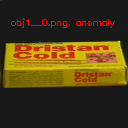

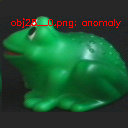

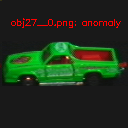

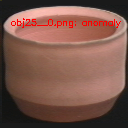

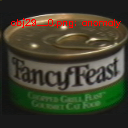

...

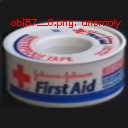

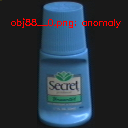

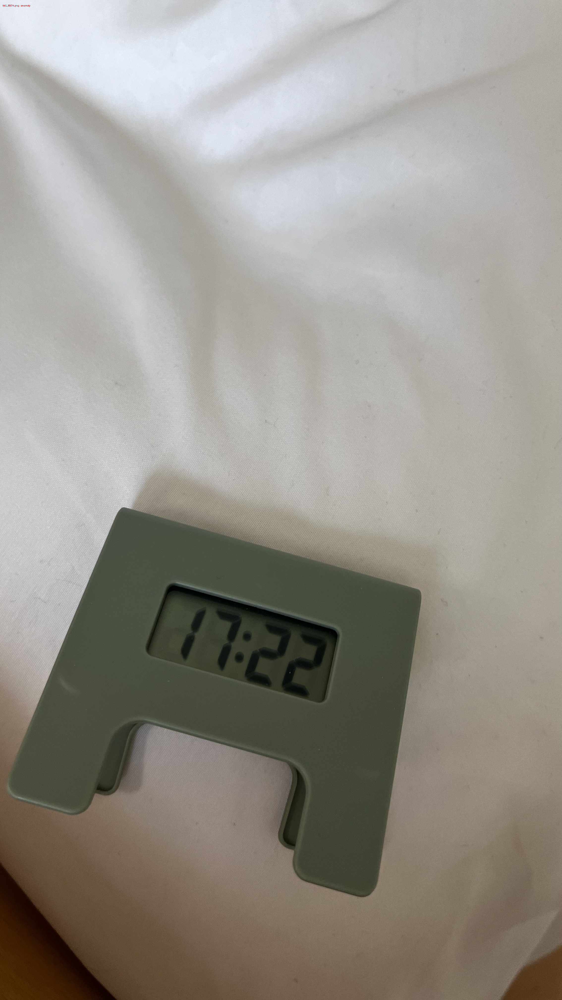

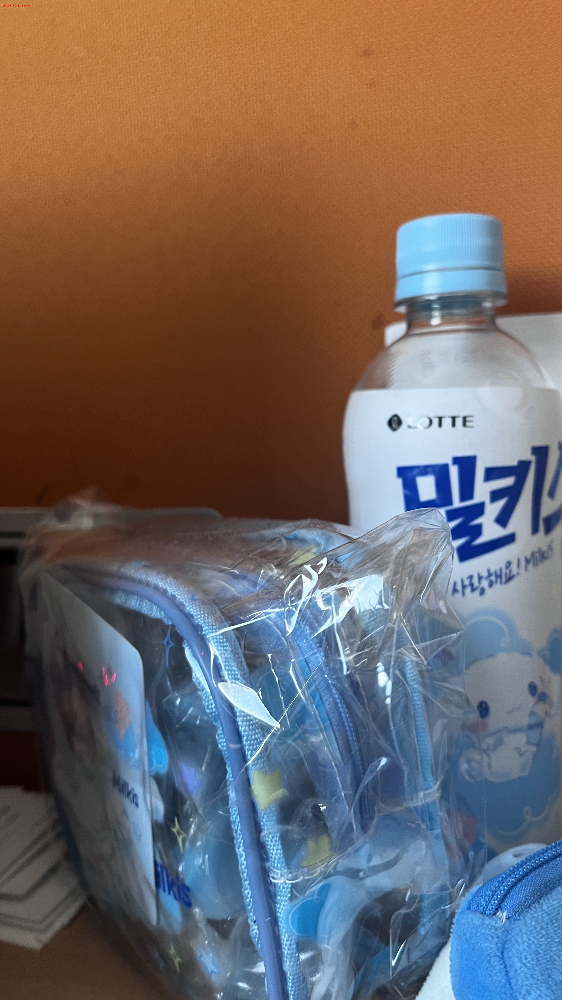

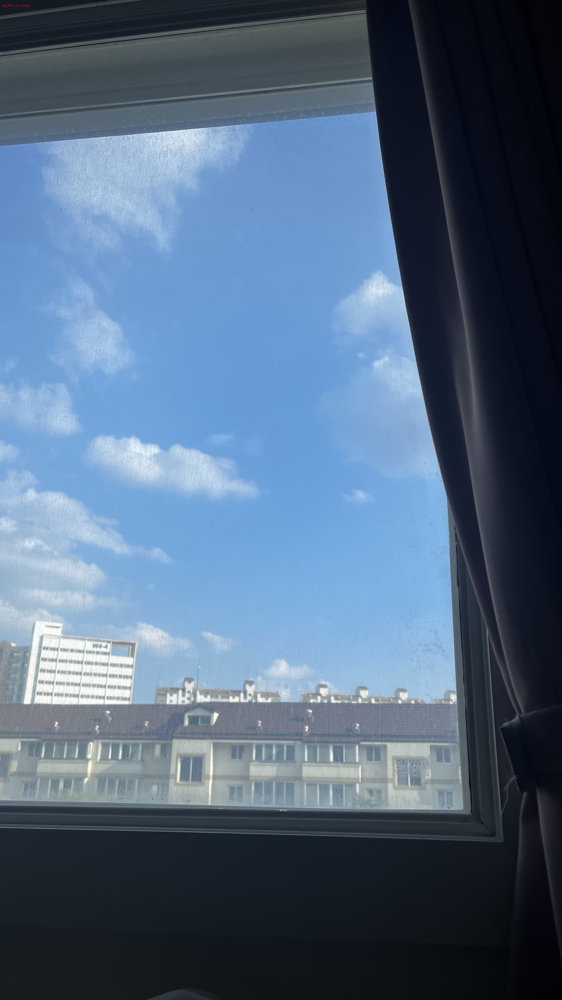

In [ ]:
# use the anomaly detector model and extracted features to determine
# if the example image is an anomaly or not
results = []
for i in range(len(test_data_paths)):
  image = cv2.imread(test_data_paths[i])
  hsv = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
  features = quantify_image(hsv, bins=(3, 3, 3))
  preds = model.predict([features])[0]
  label = test_data_paths[i].split('/')[-1]
  label += ": anomaly" if preds == -1 else ": normal"
  color = (0, 0, 255) if preds == -1 else (0, 255, 0)
  # draw the predicted label text on the original image
  cv2.putText(image, label, (10,  25), cv2.FONT_HERSHEY_SIMPLEX,
    0.3, color, 1)
  # display the image
  cv2_imshow(image)

  results.append({"label": label, "path": test_data_paths[i]})

In [ ]:
results

[{'label': 'obj1__0.png: anomaly',
  'path': '/content/gdrive/MyDrive/SUTD/Term 6 KAIST/CS470 Introduction to Artificial Intelligence/FRIGGIN ROBOT/Dataset/random_test_images/obj1__0.png'},
 {'label': 'obj28__0.png: anomaly',
  'path': '/content/gdrive/MyDrive/SUTD/Term 6 KAIST/CS470 Introduction to Artificial Intelligence/FRIGGIN ROBOT/Dataset/random_test_images/obj28__0.png'},
 {'label': 'obj27__0.png: anomaly',
  'path': '/content/gdrive/MyDrive/SUTD/Term 6 KAIST/CS470 Introduction to Artificial Intelligence/FRIGGIN ROBOT/Dataset/random_test_images/obj27__0.png'},
 {'label': 'obj25__0.png: anomaly',
  'path': '/content/gdrive/MyDrive/SUTD/Term 6 KAIST/CS470 Introduction to Artificial Intelligence/FRIGGIN ROBOT/Dataset/random_test_images/obj25__0.png'},
 {'label': 'obj29__0.png: anomaly',
  'path': '/content/gdrive/MyDrive/SUTD/Term 6 KAIST/CS470 Introduction to Artificial Intelligence/FRIGGIN ROBOT/Dataset/random_test_images/obj29__0.png'},
 {'label': 'obj26__0.png: anomaly',
  'pat



---



# Object Detection

In [ ]:
import glob

## Uploading Images using API

In [ ]:
nail_clippers_sterilised = '/content/gdrive/MyDrive/SUTD/Term 6 KAIST/CS470 Introduction to Artificial Intelligence/FRIGGIN ROBOT/Dataset/new dataset/nail-clippers1/sterilized/'
scissors_sterilised = '/content/gdrive/MyDrive/SUTD/Term 6 KAIST/CS470 Introduction to Artificial Intelligence/FRIGGIN ROBOT/Dataset/new dataset/scissors1/sterilized/'
nail_clippers_unsterilised = '/content/gdrive/MyDrive/SUTD/Term 6 KAIST/CS470 Introduction to Artificial Intelligence/FRIGGIN ROBOT/Dataset/new dataset/nail-clippers1/unsterilized/'
scissors_unsterilised = '/content/gdrive/MyDrive/SUTD/Term 6 KAIST/CS470 Introduction to Artificial Intelligence/FRIGGIN ROBOT/Dataset/new dataset/scissors/unsterilized/'
none_sterilised = '/content/gdrive/MyDrive/SUTD/Term 6 KAIST/CS470 Introduction to Artificial Intelligence/FRIGGIN ROBOT/Dataset/new dataset/none/sterilized'
none_unsterilised = '/content/gdrive/MyDrive/SUTD/Term 6 KAIST/CS470 Introduction to Artificial Intelligence/FRIGGIN ROBOT/Dataset/new dataset/none/unsterilized'

sterilised_image_paths = []
unsterilised_image_paths = []

sterilised_image_paths += glob.glob(nail_clippers_sterilised + '/*.JPG')
sterilised_image_paths += glob.glob(scissors_sterilised + '/*.JPG')
sterilised_image_paths += glob.glob(none_sterilised + '/*.JPG')
unsterilised_image_paths += glob.glob(nail_clippers_unsterilised + '/*.JPG')
unsterilised_image_paths += glob.glob(scissors_unsterilised + '/*.JPG')
unsterilised_image_paths += glob.glob(none_unsterilised + '/*.JPG')

In [ ]:
# X = dataset paths for inputs consisting of both nail clipper dataset and scissors dataset
X = sterilised_image_paths + unsterilised_image_paths

# y = class (sterilised [1] / unsterilised [0])
labels = []
for path in range(len(sterilised_image_paths)):
  labels.append(1)
for path in range(len(unsterilised_image_paths)):
  labels.append(0)
y = labels

In [ ]:
# !pip install roboflow

In [ ]:
# importing the roboflow Python Package
from roboflow import Roboflow

# creating the Roboflow object
# obtaining your API key: https://docs.roboflow.com/rest-api#obtaining-your-api-key
rf = Roboflow(api_key="EdMQQpIClNRzSt4WA4OW")

# using the workspace method on the Roboflow object
workspace = rf.workspace()

# identifying the project for upload
project = workspace.project("object-detection-hfukv")

loading Roboflow workspace...
loading Roboflow project...


## Import Libraries

In [1]:
!pip install ultralytics
!pip install roboflow

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 595.6/595.6 kB 11.1 MB/s eta 0:00:00
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 kB 3.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.8/58.8 kB 5.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 67.8/67.8 kB 8.1 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 54.5/54.5 kB 6.3 MB/s eta 0:00:00
  Created wheel for wget: filename=wget-3.2-py3-none-any.whl size=9657 sha256=dc962bbd6d0cfe319ca1d2e65ad630f6c4430a2bf8e0b606d6c1978589269077
  Stored in directory: /root/.cache/pip/wheels/8b/f1/7f/5c94f0a7a505ca1c81cd1d9208ae2064675d97582078e6c769
Successfully built wget
  Attempting uninstall: pyparsing
    Found existing installation: pyparsing 3.0.9
   

In [ ]:
from roboflow import Roboflow

rf = Roboflow(api_key="EdMQQpIClNRzSt4WA4OW")
project = rf.workspace("cs470").project("object-detection-new-9bjba")
dataset = project.version(1).download("yolov8")

loading Roboflow workspace...
loading Roboflow project...
Dependency ultralytics<=8.0.20 is required but found version=8.0.114, to fix: `pip install ultralytics<=8.0.20`


Extracting Dataset Version Zip to Object-Detection-(NEW)-1 in yolov8:: 100%|██████████| 1642/1642 [00:00<00:00, 2083.53it/s]


In [ ]:
!yolo task=detect mode=train model=yolov8s.pt data="/content/Object-Detection-(NEW)-1/data.yaml" epochs=100 imgsz=640

Ultralytics YOLOv8.0.114 🚀 Python-3.10.11 torch-2.0.1+cu118 CPU
yolo/engine/trainer: task=detect, mode=train, model=yolov8s.pt, data=/content/Object-Detection-(NEW)-1/data.yaml, epochs=100, patience=50, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=None, exist_ok=False, pretrained=False, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=0, resume=False, amp=True, fraction=1.0, profile=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, show=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, vid_stride=1, line_width=None, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, boxes=True, format=torchscript, keras=False, optimize=False, int8=False, dynamic=Fals

In [ ]:
!yolo task=detect mode=val model="content/runs/detect/train/weights/best.pt" data="/content/Object-Detection-(NEW)-1/data.yaml"

In [ ]:
!yolo task=detect mode=predict model="/content/runs/detect/train/weights/best.pt" conf=0.25 source="/content/Object-Detection-(NEW)-1/test/images"

In [ ]:
project.version({dataset.version}).deploy(model_type="yolov8", model_path="content/Object-Detection-(NEW)-1/runs/detect/train/")

In [ ]:
# !pip install colab-xterm

In [ ]:
%load_ext colabxterm
%xterm

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 115.3/115.3 kB 2.9 MB/s eta 0:00:00


Launching Xterm...

<IPython.core.display.Javascript object>

## Testing of Use of Hosted APIs to Launch Roboflow

In [3]:
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [5]:
nail_clippers_sterilised = '/content/gdrive/MyDrive/SUTD/Term 6 KAIST/CS470 Introduction to Artificial Intelligence/FRIGGIN ROBOT/Dataset/new dataset/nail-clippers1/sterilized/'
scissors_sterilised = '/content/gdrive/MyDrive/SUTD/Term 6 KAIST/CS470 Introduction to Artificial Intelligence/FRIGGIN ROBOT/Dataset/new dataset/scissors1/sterilized/'
nail_clippers_unsterilised = '/content/gdrive/MyDrive/SUTD/Term 6 KAIST/CS470 Introduction to Artificial Intelligence/FRIGGIN ROBOT/Dataset/new dataset/nail-clippers1/unsterilized/'
scissors_unsterilised = '/content/gdrive/MyDrive/SUTD/Term 6 KAIST/CS470 Introduction to Artificial Intelligence/FRIGGIN ROBOT/Dataset/new dataset/scissors/unsterilized/'
none_sterilised = '/content/gdrive/MyDrive/SUTD/Term 6 KAIST/CS470 Introduction to Artificial Intelligence/FRIGGIN ROBOT/Dataset/new dataset/none/sterilized'
none_unsterilised = '/content/gdrive/MyDrive/SUTD/Term 6 KAIST/CS470 Introduction to Artificial Intelligence/FRIGGIN ROBOT/Dataset/new dataset/none/unsterilized'

sterilised_image_paths = []
unsterilised_image_paths = []

sterilised_image_paths += glob.glob(nail_clippers_sterilised + '/*.JPG')
sterilised_image_paths += glob.glob(scissors_sterilised + '/*.JPG')
sterilised_image_paths += glob.glob(none_sterilised + '/*.JPG')
unsterilised_image_paths += glob.glob(nail_clippers_unsterilised + '/*.JPG')
unsterilised_image_paths += glob.glob(scissors_unsterilised + '/*.JPG')
unsterilised_image_paths += glob.glob(none_unsterilised + '/*.JPG')

loading Roboflow workspace...
loading Roboflow project...
{'predictions': [{'x': 1556, 'y': 1384, 'width': 543, 'height': 841, 'confidence': 0.9678516387939453, 'class': 'nail clippers', 'image_path': '/content/gdrive/MyDrive/SUTD/Term 6 KAIST/CS470 Introduction to Artificial Intelligence/FRIGGIN ROBOT/Dataset/new dataset/nail-clippers1/unsterilized/IMG_0077.JPG', 'prediction_type': 'ObjectDetectionModel'}, {'x': 1308, 'y': 1471, 'width': 292, 'height': 373, 'confidence': 0.9328320026397705, 'class': 'unsterilised', 'image_path': '/content/gdrive/MyDrive/SUTD/Term 6 KAIST/CS470 Introduction to Artificial Intelligence/FRIGGIN ROBOT/Dataset/new dataset/nail-clippers1/unsterilized/IMG_0077.JPG', 'prediction_type': 'ObjectDetectionModel'}, {'x': 1682, 'y': 1930, 'width': 472, 'height': 656, 'confidence': 0.8003301620483398, 'class': 'unsterilised', 'image_path': '/content/gdrive/MyDrive/SUTD/Term 6 KAIST/CS470 Introduction to Artificial Intelligence/FRIGGIN ROBOT/Dataset/new dataset/nail-c

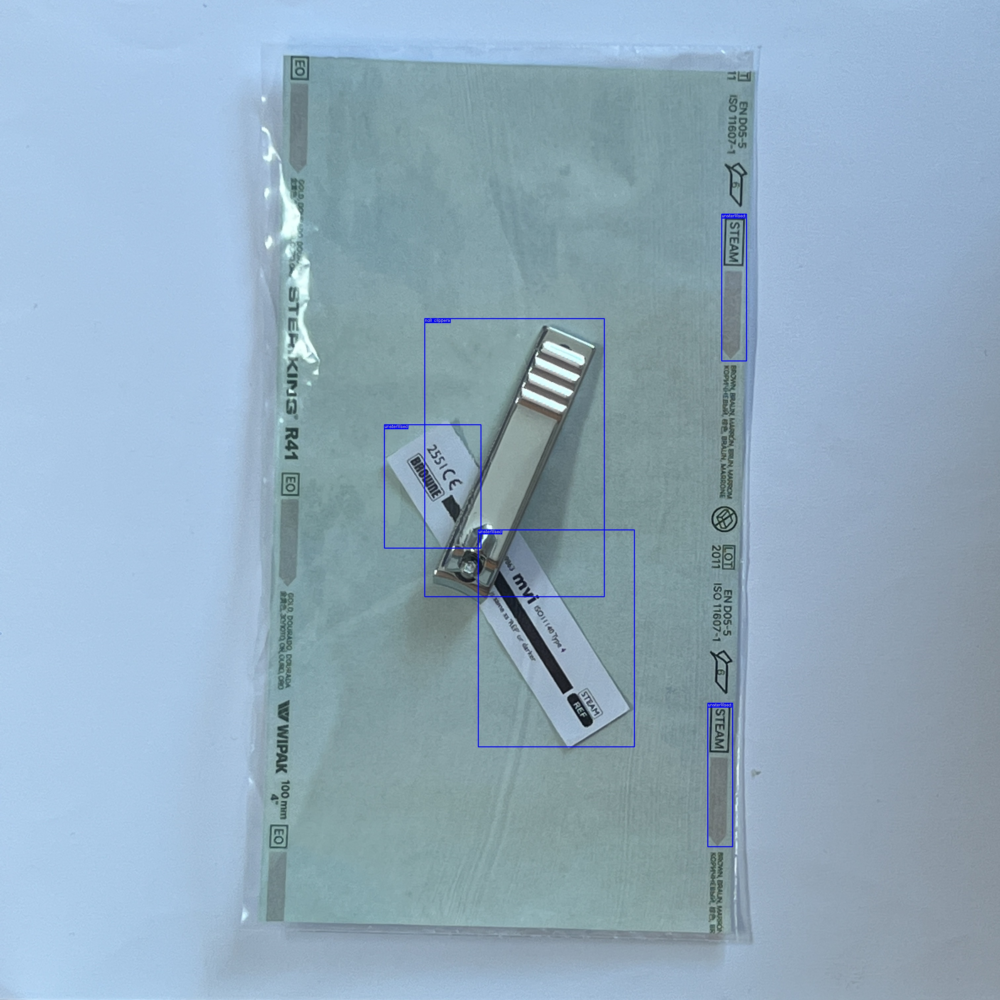

In [13]:
from roboflow import Roboflow
rf = Roboflow(api_key="EdMQQpIClNRzSt4WA4OW")
project = rf.workspace("cs470").project("object-detection-new-9bjba")
model = project.version(1).model

input_image_path = unsterilised_image_paths[5] # TODO: change this to get image from real-time input

# infer on a local image
print(model.predict(input_image_path, confidence=40, overlap=30).json())

# visualize your prediction
model.predict(input_image_path, confidence=40, overlap=30).save("prediction.jpg")

from IPython.display import Image
Image('prediction.jpg', width=300)